In [75]:
display("text/html", "<style>.container { width:100% !important; }</style>")

In [391]:
# import all the relevant packages.
using Plots, LaTeXStrings, Distributions, DoubleFloats, Plots.PlotMeasures, LinearAlgebra, DataFrames, CSV, LsqFit, StatsBase, Distances
Plots.theme(:dao)

In [375]:
pal = cgrad(:tol_muted);
cpal = [pal[i] for i in 0.1:0.1:1.0]

# First let's do for the new data in "Single-cell new RNA sequencing reveals principles of transcription at the resolution of individual bursts"

Other ideas:
- Plot burst frequency and burst size against EPR for each gene (scatter).

In [386]:
raw_data = CSV.read("./data/2024-fig2d-data.csv", DataFrame, header = 2);
all_data = raw_data[raw_data.success .== true, :];

Create EPR function from the parameters.

In [211]:
epr(ron,roff,son,soff,e) = ((ron-roff)*son*soff/((son+soff)*(e+son+soff)))*log(ron/roff)

epr (generic function with 1 method)

In [212]:
epr(1.0,2.0,1.0,1.0,1.0)

0.11552453009332421

Create the EPR distribution over all combinations of parameters.

In [213]:
e = 10^-2; # note that thos could in principle be variable from gene to gene.

In [214]:
all_data[2,:]

Row,Column1,kon,koff,ksyn,burst_size,success
,String31,Float64,Float64,Float64,Float64,Bool
2,ENSMUSG00000000028.16,0.270793,18.0899,80.1579,4.4311,true


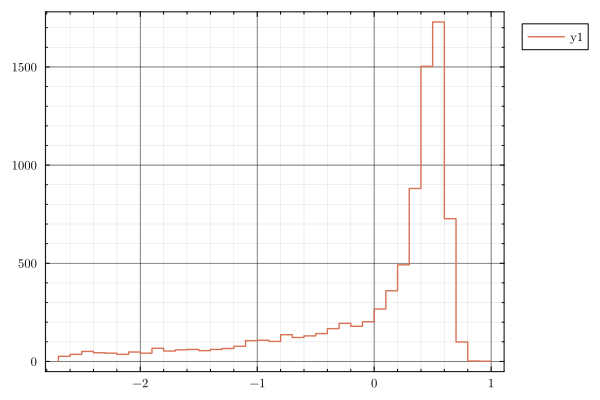

In [215]:
stephist(log10.([all_data[i,:][2] for i in 1:size(all_data)[1]]))

In [216]:
round.(real_epr_vec,digits = 7);

In [217]:
real_epr_vec = zeros(size(all_data)[1]);
for i in 1:nrow(all_data)
    son_i = all_data[i,:][2]; soff_i = all_data[i,:][3]; ron_i = all_data[i,:][4]; roff_i = all_data[i,:][4]/100; 
    real_epr_vec[i] = epr(ron_i, roff_i, son_i, soff_i, e)
end

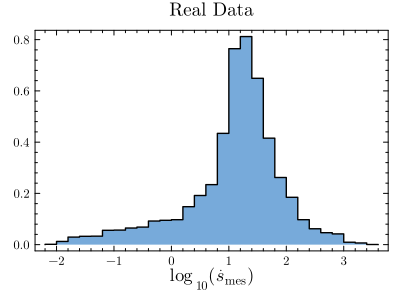

In [292]:
p1 = stephist(log10.(real_epr_vec), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[1], linecolor = :black)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", title = "Real Data")

In [460]:
burst_sizes = all_data[!,:ksyn]./all_data[!,:koff]; burst_freqs = all_data[!,:kon];

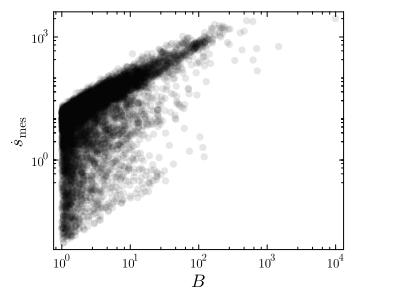

In [474]:
scatter(burst_sizes,real_epr_vec, xaxis = :log, yaxis = :log, label = :none, color = :black, alpha = 0.1)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"B", ylabel = L"\dot{s}_{\mathrm{mes}}")

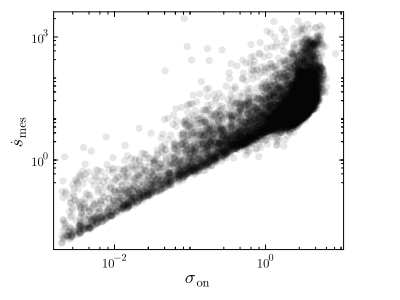

In [476]:
scatter(burst_freqs,real_epr_vec, xaxis = :log, yaxis = :log, label = :none, color = :black, alpha = 0.1)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\sigma_{\mathrm{on}}", ylabel = L"\dot{s}_{\mathrm{mes}}")

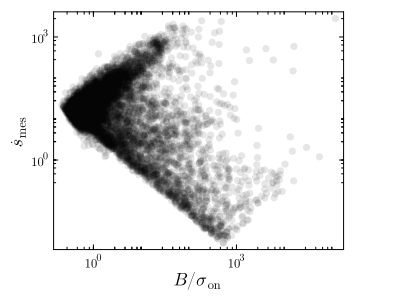

In [478]:
scatter(burst_sizes./burst_freqs,real_epr_vec, xaxis = :log, yaxis = :log, label = :none, color = :black, alpha = 0.1)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"B/\sigma_{\mathrm{on}}", ylabel = L"\dot{s}_{\mathrm{mes}}")

In [392]:
f1 = fit(Histogram, log10.(real_epr_vec), nbins = 30);
mps1 = midpoints(collect(f1.edges[1]));
bin_width1 = mps1[2]-mps1[1];
pdf1 = f1.weights/(bin_width1*sum(f1.weights));

In [393]:
# Gaussian function: y = A * exp(-(x - μ)^2 / (2 * σ^2))
gaussian(x, p) = @. p[1] * exp(-(x - p[2])^2 / (2 * p[3]^2))

gaussian (generic function with 1 method)

In [395]:
# Initial guess for the parameters: [Amplitude, Mean, Standard Deviation]
p0 = [2.5, 0.5, 1.0]

# Perform the fit
g_fit1 = curve_fit(gaussian, mps1, pdf1, p0);

g_vec1 = [gaussian(x, g_fit1.param) for x in mps1];

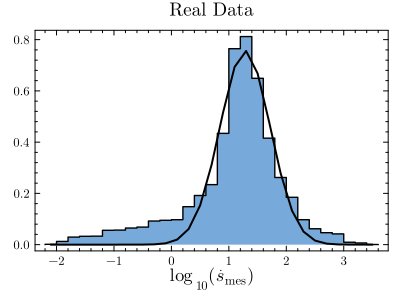

In [397]:
p1 = stephist(log10.(real_epr_vec), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[1], linecolor = :black)
plot!(mps1,g_vec1, color = :black, lw = 2)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", title = "Real Data")

In [219]:
rand_epr_vec = zeros(size(all_data)[1]);
for i in 1:nrow(all_data)
    son_i = all_data[rand(1:length(rand_epr_vec)),:][2]; soff_i = all_data[rand(1:length(rand_epr_vec)),:][3]; 
    ron_i = all_data[rand(1:length(rand_epr_vec)),:][4]; roff_i = ron_i/100; 
    rand_epr_vec[i] = epr(ron_i, roff_i, son_i, soff_i, e)
end

In [220]:
rand_epr_vec2 = zeros(size(all_data)[1]);
for i in 1:nrow(all_data)
    son_i = all_data[rand(1:length(rand_epr_vec)),:][2]; soff_i = all_data[rand(1:length(rand_epr_vec)),:][3]; 
    ron_i = all_data[rand(1:length(rand_epr_vec)),:][4]; roff_i = ron_i/100; 
    rand_epr_vec2[i] = epr(ron_i, roff_i, son_i, soff_i, e)
end

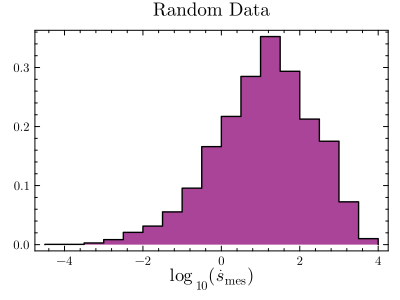

In [293]:
p2 = stephist(log10.(rand_epr_vec), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[end], linecolor = :black)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", title = "Random Data")

In [398]:
f2 = fit(Histogram, log10.(rand_epr_vec), nbins = 30);
mps2 = midpoints(collect(f2.edges[1]));
bin_width2 = mps2[2]-mps2[1];
pdf2 = f2.weights/(bin_width2*sum(f2.weights));

In [399]:
# Initial guess for the parameters: [Amplitude, Mean, Standard Deviation]
p0 = [2.5, 0.5, 1.0]

# Perform the fit
g_fit2 = curve_fit(gaussian, mps2, pdf2, p0);

g_vec2 = [gaussian(x, g_fit2.param) for x in mps2];

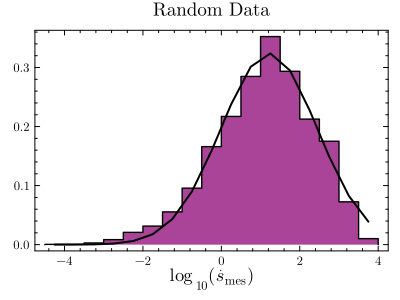

In [402]:
p2 = stephist(log10.(rand_epr_vec), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[end], linecolor = :black)
plot!(mps2,g_vec2, color = :black, lw = 2)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", title = "Random Data")

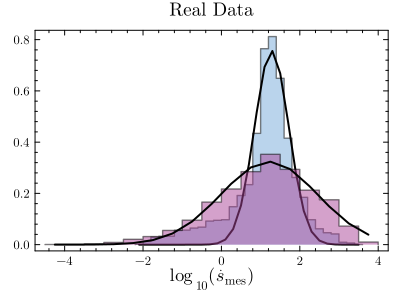

In [403]:
p12comb = stephist(log10.(real_epr_vec), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[1], linecolor = :black, alpha = 0.5)
plot!(mps1,g_vec1, color = :black, lw = 2)
stephist!(log10.(rand_epr_vec), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[end], linecolor = :black, alpha = 0.5)
plot!(mps2,g_vec2, color = :black, lw = 2)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", title = "Real Data")

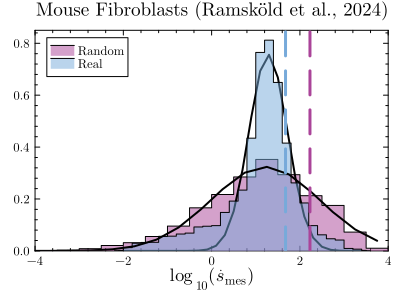

In [426]:
p12comb = stephist(log10.(rand_epr_vec), bins=30, fill=true, norm = true, label = "Random", legend = :topleft, fillcolor = cpal[end], linecolor = :black, lw = 1, alpha = 0.5, linealpha = 1)
plot!(mps1,g_vec1, color = :black, lw = 2, label = :none)
stephist!(log10.(real_epr_vec), bins=30, fill=true, norm = true, label = "Real", fillcolor = cpal[1], linecolor = :black, alpha = 0.5, lw = 1, linealpha = 1)
plot!(mps2,g_vec2, color = :black, lw = 2, label = :none)
plot!(log10.([mean(real_epr_vec),mean(real_epr_vec)]),[-10,10], color = cpal[1], lw = 3, linestyle = :dash, label = :none)
plot!(log10.([mean(rand_epr_vec),mean(rand_epr_vec)]),[-10,10], color = cpal[end], lw = 3, linestyle = :dash, label = :none)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", xlims = [-4,4], ylims = [0,0.85], title = "Mouse Fibroblasts (Ramsköld et al., 2024)")

In [417]:
mean(real_epr_vec)

47.233887766706026

In [236]:
median(real_epr_vec)

16.623833592277315

In [234]:
std(real_epr_vec)

130.2490322103768

In [231]:
mean(rand_epr_vec)

168.99453111959207

In [237]:
median(rand_epr_vec)

15.01735814077994

In [235]:
std(rand_epr_vec)

499.44587037244463

Interesting consequences here...

Can also do the cyclic $CV^2$ of the EPR!

In [239]:
cyclic_epr_vec = zeros(size(all_data)[1]);
for i in 1:nrow(all_data)
    son_i = all_data[i,:][2]; soff_i = all_data[i,:][3]; ron_i = all_data[i,:][4]; roff_i = all_data[i,:][4]/100; 
    cyclic_epr_vec[i] = (son_i^2+soff_i^2)/(son_i+soff_i)^2
end

In [242]:
cyc_rand_epr_vec = zeros(size(all_data)[1]);
for i in 1:nrow(all_data)
    son_i = all_data[rand(1:length(rand_epr_vec)),:][2]; soff_i = all_data[rand(1:length(rand_epr_vec)),:][3]; 
    ron_i = all_data[rand(1:length(rand_epr_vec)),:][4]; roff_i = ron_i/100; 
    cyc_rand_epr_vec[i] = (son_i^2+soff_i^2)/(son_i+soff_i)^2
end

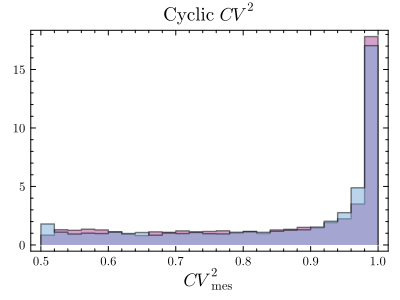

In [479]:
stephist(cyclic_epr_vec, bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[end], linecolor = :black, alpha = 0.5)
stephist!(cyc_rand_epr_vec, bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[1], linecolor = :black, alpha = 0.5)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"CV^2_{\mathrm{mes}}", title = L"Cyclic $CV^2$")

# Second let's do for the old data in "Genomic encoding of transcriptional burst kinetics"

## Stem Cells C57

In [291]:
raw_data_esc_c57 = CSV.read("./data/Larrson-2019-ESC-C57.csv", DataFrame, header = 1)[!,2]
all_data_esc_c57_vec = [
    parse.(Float64, split(replace(strip(s, ['[', ']']), "," => " "))) 
    for s in raw_data_esc_c57
]
matrix_esc_c57 = transpose(reshape(vcat(all_data_esc_c57_vec...),(3,length(all_data_esc_c57_vec))))
all_data_esc_c57 = DataFrame(matrix_esc_c57, [:kon, :koff, :ksyn]);

In [281]:
real_epr_vec_esc_c57 = zeros(size(all_data_esc_c57)[1]);
for i in 1:nrow(all_data_esc_c57)
    son_i = all_data_esc_c57[i,:][1]; soff_i = all_data_esc_c57[i,:][2]; ron_i = all_data_esc_c57[i,:][3]; roff_i = all_data_esc_c57[i,:][3]/100; 
    real_epr_vec_esc_c57[i] = epr(ron_i, roff_i, son_i, soff_i, e)
end

In [430]:
f3 = fit(Histogram, log10.(real_epr_vec_esc_c57), nbins = 30);
mps3 = midpoints(collect(f3.edges[1]));
bin_width3 = mps3[2]-mps3[1];
pdf3 = f3.weights/(bin_width3*sum(f3.weights));

# Initial guess for the parameters: [Amplitude, Mean, Standard Deviation]
p0 = [2.5, 0.5, 1.0]

# Perform the fit
g_fit3 = curve_fit(gaussian, mps3, pdf3, p0);

g_vec3 = [gaussian(x, g_fit3.param) for x in mps3];

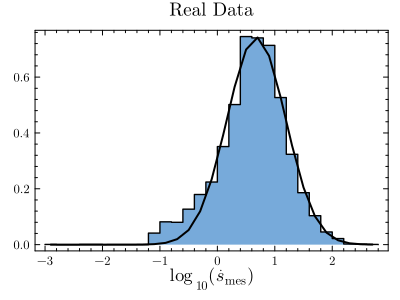

In [431]:
p3 = stephist(log10.(real_epr_vec_esc_c57), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[1], linecolor = :black)
plot!(mps3,g_vec3, color = :black, lw = 2)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", title = "Real Data")

In [480]:
burst_sizes_esc_c57 = all_data_esc_c57[!,:ksyn]./all_data_esc_c57[!,:koff]; burst_freqs_esc_c57 = all_data_esc_c57[!,:kon];

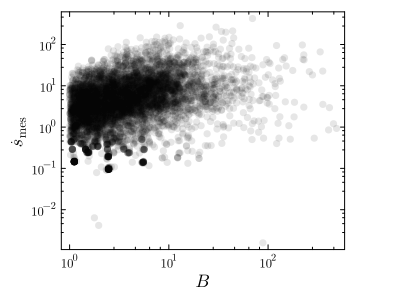

In [483]:
scatter(burst_sizes_esc_c57,real_epr_vec_esc_c57, xaxis = :log, yaxis = :log, label = :none, color = :black, alpha = 0.1)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"B", ylabel = L"\dot{s}_{\mathrm{mes}}")

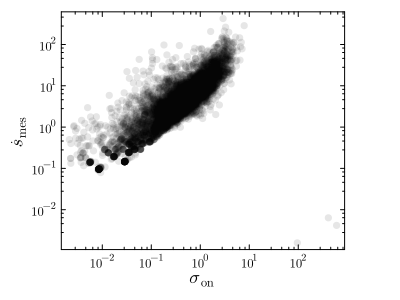

In [482]:
scatter(burst_freqs_esc_c57,real_epr_vec_esc_c57, xaxis = :log, yaxis = :log, label = :none, color = :black, alpha = 0.1)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\sigma_{\mathrm{on}}", ylabel = L"\dot{s}_{\mathrm{mes}}")

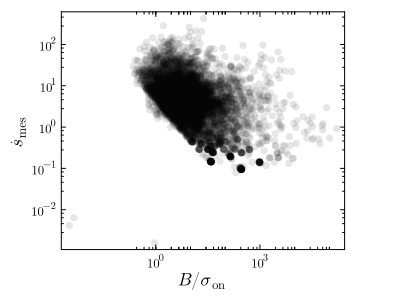

In [481]:
scatter(burst_sizes_esc_c57./burst_freqs_esc_c57,real_epr_vec_esc_c57, xaxis = :log, yaxis = :log, label = :none, color = :black, alpha = 0.1)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"B/\sigma_{\mathrm{on}}", ylabel = L"\dot{s}_{\mathrm{mes}}")

In [285]:
rand_epr_vec_esc_c57 = zeros(size(all_data_esc_c57)[1]);
for i in 1:nrow(all_data_esc_c57)
    son_i = all_data_esc_c57[rand(1:size(all_data_esc_c57)[1]),:][1]; soff_i = all_data_esc_c57[rand(1:size(all_data_esc_c57)[1]),:][2]; 
    ron_i = all_data_esc_c57[rand(1:size(all_data_esc_c57)[1]),:][3]; roff_i = all_data_esc_c57[rand(1:size(all_data_esc_c57)[1]),:][3]/100; 
    rand_epr_vec_esc_c57[i] = epr(ron_i, roff_i, son_i, soff_i, e)
end

In [434]:
f4 = fit(Histogram, log10.(rand_epr_vec_esc_c57), nbins = 30);
mps4 = midpoints(collect(f4.edges[1]));
bin_width4 = mps4[2]-mps4[1];
pdf4 = f4.weights/(bin_width4*sum(f4.weights));

# Initial guess for the parameters: [Amplitude, Mean, Standard Deviation]
p0 = [2.5, 0.5, 1.0]

# Perform the fit
g_fit4 = curve_fit(gaussian, mps4, pdf4, p0);

g_vec4 = [gaussian(x, g_fit4.param) for x in mps4];

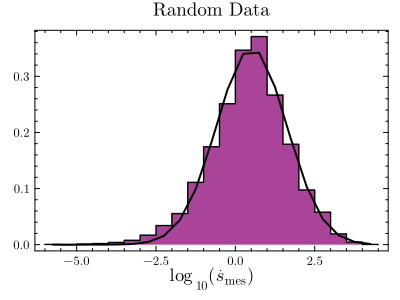

In [435]:
p4 = stephist(log10.(rand_epr_vec_esc_c57), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[end], linecolor = :black)
plot!(mps4,g_vec4, color = :black, lw = 2)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", title = "Random Data")

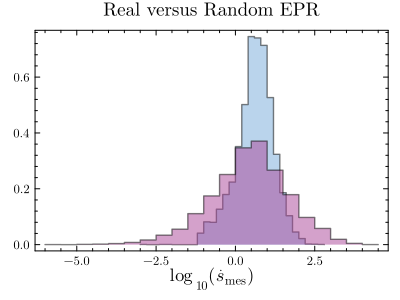

In [301]:
p34comb = stephist(log10.(real_epr_vec_esc_c57), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[1], linecolor = :black, alpha = 0.5)
stephist!(log10.(rand_epr_vec_esc_c57), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[end], linecolor = :black, alpha = 0.5)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", title = "Real versus Random EPR")

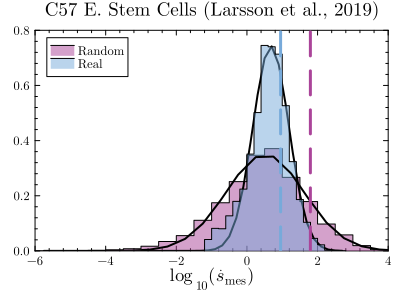

In [448]:
p34comb = stephist(log10.(rand_epr_vec_esc_c57), bins=30, fill=true, norm = true, label = "Random", legend = :topleft, fillcolor = cpal[end], linecolor = :black, lw = 1, alpha = 0.5, linealpha = 1)
plot!(mps3,g_vec3, color = :black, lw = 2, label = :none)
stephist!(log10.(real_epr_vec_esc_c57), bins=30, fill=true, norm = true, label = "Real", fillcolor = cpal[1], linecolor = :black, alpha = 0.5, lw = 1, linealpha = 1)
plot!(mps4,g_vec4, color = :black, lw = 2, label = :none)
plot!(log10.([mean(real_epr_vec_esc_c57),mean(real_epr_vec_esc_c57)]),[-10,10], color = cpal[1], lw = 3, linestyle = :dash, label = :none)
plot!(log10.([mean(rand_epr_vec_esc_c57),mean(rand_epr_vec_esc_c57)]),[-10,10], color = cpal[end], lw = 3, linestyle = :dash, label = :none)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", xlims = [-6,4], ylims = [0,0.8], title = "C57 E. Stem Cells (Larsson et al., 2019)")

In [340]:
mean(real_epr_vec_esc_c57)

8.98230541665327

In [341]:
median(real_epr_vec_esc_c57)

4.418183708973501

In [342]:
std(real_epr_vec_esc_c57)

16.06348052415475

In [343]:
mean(rand_epr_vec_esc_c57)

62.587257952864384

In [344]:
median(rand_epr_vec_esc_c57)

3.1382029344201054

In [345]:
std(rand_epr_vec_esc_c57)

370.74157858867494

Interesting consequences here...

Can also do the cyclic $CV^2$ of the EPR!

In [347]:
cyclic_epr_vec_esc_c57 = zeros(size(all_data_esc_c57)[1]);
for i in 1:nrow(all_data_esc_c57)
    son_i = all_data_esc_c57[i,:][1]; soff_i = all_data_esc_c57[i,:][2]; ron_i = all_data_esc_c57[i,:][3]; roff_i = all_data_esc_c57[i,:][3]/100; 
    cyclic_epr_vec_esc_c57[i] = (son_i^2+soff_i^2)/(son_i+soff_i)^2
end

In [349]:
cyc_rand_epr_vec_esc_c57 = zeros(size(all_data_esc_c57)[1]);
for i in 1:nrow(all_data_esc_c57)
    son_i = all_data_esc_c57[rand(1:size(all_data_esc_c57)[1]),:][1]; soff_i = all_data_esc_c57[rand(1:size(all_data_esc_c57)[1]),:][2]; 
    ron_i = all_data_esc_c57[rand(1:size(all_data_esc_c57)[1]),:][3]; roff_i = ron_i/100; 
    cyc_rand_epr_vec_esc_c57[i] = (son_i^2+soff_i^2)/(son_i+soff_i)^2
end

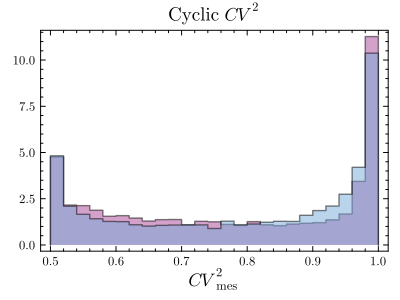

In [350]:
stephist(cyclic_epr_vec_esc_c57, bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[end], linecolor = :black, alpha = 0.5)
stephist!(cyc_rand_epr_vec_esc_c57, bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[1], linecolor = :black, alpha = 0.5)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"CV^2_{\mathrm{mes}}", title = L"Cyclic $CV^2$")

## Stem Cells CAST

In [295]:
raw_data_esc_CAST = CSV.read("./data/Larrson-2019-ESC-CAST.csv", DataFrame, header = 1)[!,2]
all_data_esc_CAST_vec = [
    parse.(Float64, split(replace(strip(s, ['[', ']']), "," => " "))) 
    for s in raw_data_esc_CAST
]
matrix_esc_CAST = transpose(reshape(vcat(all_data_esc_CAST_vec...),(3,length(all_data_esc_CAST_vec))))
all_data_esc_CAST = DataFrame(matrix_esc_CAST, [:kon, :koff, :ksyn]);

In [296]:
real_epr_vec_esc_CAST = zeros(size(all_data_esc_CAST)[1]);
for i in 1:nrow(all_data_esc_CAST)
    son_i = all_data_esc_CAST[i,:][1]; soff_i = all_data_esc_CAST[i,:][2]; ron_i = all_data_esc_CAST[i,:][3]; roff_i = all_data_esc_CAST[i,:][3]/100; 
    real_epr_vec_esc_CAST[i] = epr(ron_i, roff_i, son_i, soff_i, e)
end

In [451]:
f5 = fit(Histogram, log10.(real_epr_vec_esc_CAST), nbins = 30);
mps5 = midpoints(collect(f5.edges[1]));
bin_width5 = mps5[2]-mps5[1];
pdf5 = f5.weights/(bin_width5*sum(f5.weights));

# Initial guess for the parameters: [Amplitude, Mean, Standard Deviation]
p0 = [2.5, 0.5, 1.0]

# Perform the fit
g_fit5 = curve_fit(gaussian, mps5, pdf5, p0);

g_vec5 = [gaussian(x, g_fit5.param) for x in mps5];

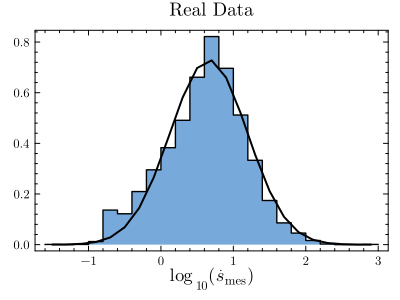

In [452]:
p5 = stephist(log10.(real_epr_vec_esc_CAST), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[1], linecolor = :black)
plot!(mps5,g_vec5, color = :black, lw = 2)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", title = "Real Data")

In [484]:
burst_sizes_esc_CAST = all_data_esc_CAST[!,:ksyn]./all_data_esc_CAST[!,:koff]; burst_freqs_esc_CAST = all_data_esc_CAST[!,:kon];

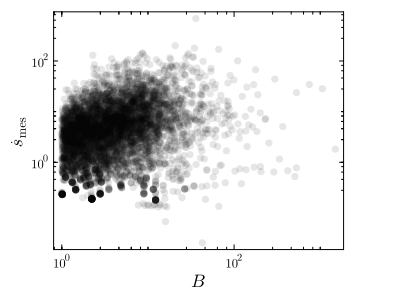

In [485]:
scatter(burst_sizes_esc_CAST,real_epr_vec_esc_CAST, xaxis = :log, yaxis = :log, label = :none, color = :black, alpha = 0.1)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"B", ylabel = L"\dot{s}_{\mathrm{mes}}")

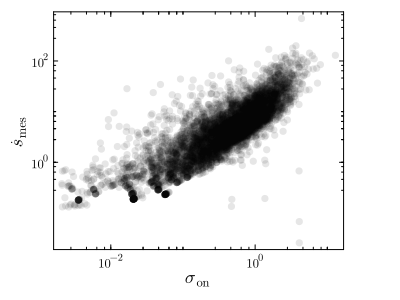

In [486]:
scatter(burst_freqs_esc_CAST,real_epr_vec_esc_CAST, xaxis = :log, yaxis = :log, label = :none, color = :black, alpha = 0.1)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\sigma_{\mathrm{on}}", ylabel = L"\dot{s}_{\mathrm{mes}}")

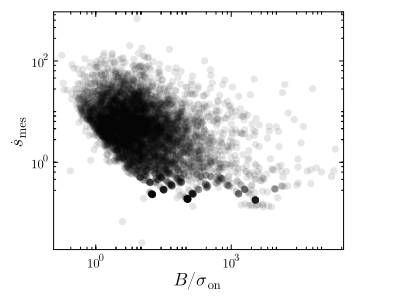

In [487]:
scatter(burst_sizes_esc_CAST./burst_freqs_esc_CAST,real_epr_vec_esc_CAST, xaxis = :log, yaxis = :log, label = :none, color = :black, alpha = 0.1)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"B/\sigma_{\mathrm{on}}", ylabel = L"\dot{s}_{\mathrm{mes}}")

In [298]:
rand_epr_vec_esc_CAST = zeros(size(all_data_esc_CAST)[1]);
for i in 1:nrow(all_data_esc_CAST)
    son_i = all_data_esc_CAST[rand(1:size(all_data_esc_CAST)[1]),:][1]; soff_i = all_data_esc_CAST[rand(1:size(all_data_esc_CAST)[1]),:][2]; 
    ron_i = all_data_esc_CAST[rand(1:size(all_data_esc_CAST)[1]),:][3]; roff_i = all_data_esc_CAST[rand(1:size(all_data_esc_CAST)[1]),:][3]/100; 
    rand_epr_vec_esc_CAST[i] = epr(ron_i, roff_i, son_i, soff_i, e)
end

In [516]:
f6 = fit(Histogram, log10.(rand_epr_vec_esc_CAST), nbins = 30);
mps6 = midpoints(collect(f6.edges[1]));
bin_width6 = mps6[2]-mps6[1];
pdf6 = f6.weights/(bin_width6*sum(f6.weights));

# Initial guess for the parameters: [Amplitude, Mean, Standard Deviation]
p0 = [2.5, 0.5, 1.0]

# Perform the fit
g_fit6 = curve_fit(gaussian, mps6, pdf6, p0);

g_vec6 = [gaussian(x, g_fit6.param) for x in mps6];

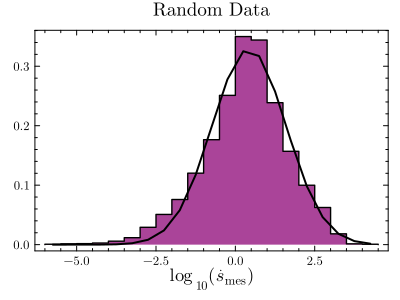

In [517]:
p6 = stephist(log10.(rand_epr_vec_esc_CAST), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[end], linecolor = :black)
plot!(mps6,g_vec6, color = :black, lw = 2)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", title = "Random Data")

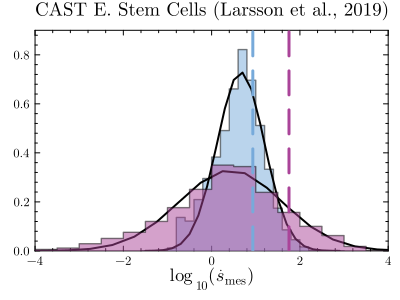

In [528]:
p56comb = stephist(log10.(real_epr_vec_esc_CAST), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[1], linecolor = :black, alpha = 0.5)
plot!(mps5,g_vec5, color = :black, lw = 2, label = :none)
plot!(mps6,g_vec6, color = :black, lw = 2, label = :none)
stephist!(log10.(rand_epr_vec_esc_CAST), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[end], linecolor = :black, alpha = 0.5)
plot!(log10.([mean(real_epr_vec_esc_CAST),mean(real_epr_vec_esc_CAST)]),[-10,10], color = cpal[1], lw = 3, linestyle = :dash, label = :none)
plot!(log10.([mean(rand_epr_vec_esc_CAST),mean(rand_epr_vec_esc_CAST)]),[-10,10], color = cpal[end], lw = 3, linestyle = :dash, label = :none)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", xlims = [-4,4], ylims = [0,0.9], title = "CAST E. Stem Cells (Larsson et al., 2019)")

In [358]:
mean(real_epr_vec_esc_CAST)

8.573291928267325

In [359]:
median(real_epr_vec_esc_CAST)

4.402731357216768

In [360]:
std(real_epr_vec_esc_CAST)

16.224379572999517

In [361]:
mean(rand_epr_vec_esc_CAST)

56.61573415046146

In [362]:
median(rand_epr_vec_esc_CAST)

2.5328782781572943

In [363]:
std(rand_epr_vec_esc_CAST)

330.52495475437365

Interesting consequences here...

Can also do the cyclic $CV^2$ of the EPR!

In [364]:
cyclic_epr_vec_esc_CAST = zeros(size(all_data_esc_CAST)[1]);
for i in 1:nrow(all_data_esc_CAST)
    son_i = all_data_esc_CAST[i,:][1]; soff_i = all_data_esc_CAST[i,:][2]; ron_i = all_data_esc_CAST[i,:][3]; roff_i = all_data_esc_CAST[i,:][3]/100; 
    cyclic_epr_vec_esc_CAST[i] = (son_i^2+soff_i^2)/(son_i+soff_i)^2
end

In [365]:
cyc_rand_epr_vec_esc_CAST = zeros(size(all_data_esc_CAST)[1]);
for i in 1:nrow(all_data_esc_CAST)
    son_i = all_data_esc_CAST[rand(1:size(all_data_esc_CAST)[1]),:][1]; soff_i = all_data_esc_CAST[rand(1:size(all_data_esc_CAST)[1]),:][2]; 
    ron_i = all_data_esc_CAST[rand(1:size(all_data_esc_CAST)[1]),:][3]; roff_i = ron_i/100; 
    cyc_rand_epr_vec_esc_CAST[i] = (son_i^2+soff_i^2)/(son_i+soff_i)^2
end

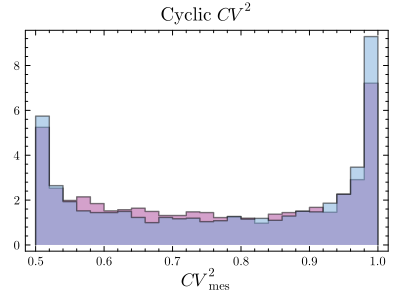

In [366]:
stephist(cyclic_epr_vec_esc_CAST, bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[end], linecolor = :black, alpha = 0.5)
stephist!(cyc_rand_epr_vec_esc_CAST, bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[1], linecolor = :black, alpha = 0.5)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"CV^2_{\mathrm{mes}}", title = L"Cyclic $CV^2$")

## Fibroblasts C57

In [308]:
raw_data_Fibroblasts_c57 = collect(skipmissing(CSV.read("./data/Larrson-2019-Fibroblasts-C57.csv", DataFrame, header = 1)[!,2]))
all_data_Fibroblasts_c57_vec = [
    parse.(Float64, split(replace(strip(s, ['[', ']']), "," => " "))) 
    for s in raw_data_Fibroblasts_c57
]
matrix_Fibroblasts_c57 = transpose(reshape(vcat(all_data_Fibroblasts_c57_vec...),(3,length(all_data_Fibroblasts_c57_vec))))
all_data_Fibroblasts_c57 = DataFrame(matrix_Fibroblasts_c57, [:kon, :koff, :ksyn]);

In [309]:
real_epr_vec_Fibroblasts_c57 = zeros(size(all_data_Fibroblasts_c57)[1]);
for i in 1:nrow(all_data_Fibroblasts_c57)
    son_i = all_data_Fibroblasts_c57[i,:][1]; soff_i = all_data_Fibroblasts_c57[i,:][2]; ron_i = all_data_Fibroblasts_c57[i,:][3]; roff_i = all_data_Fibroblasts_c57[i,:][3]/100; 
    real_epr_vec_Fibroblasts_c57[i] = epr(ron_i, roff_i, son_i, soff_i, e)
end

In [523]:
f7 = fit(Histogram, log10.(real_epr_vec_Fibroblasts_c57), nbins = 30);
mps7 = midpoints(collect(f7.edges[1]));
bin_width7 = mps7[2]-mps7[1];
pdf7 = f7.weights/(bin_width7*sum(f7.weights));

# Initial guess for the parameters: [Amplitude, Mean, Standard Deviation]
p0 = [2.5, 0.5, 1.0]

# Perform the fit
g_fit7 = curve_fit(gaussian, mps7, pdf7, p0);

g_vec7 = [gaussian(x, g_fit7.param) for x in mps7];

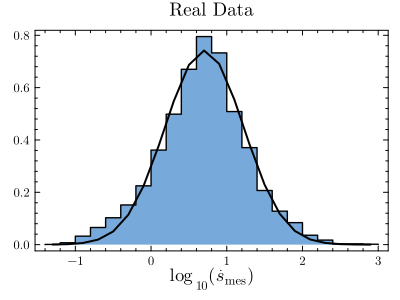

In [524]:
p7 = stephist(log10.(real_epr_vec_Fibroblasts_c57), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[1], linecolor = :black)
plot!(mps7,g_vec7, color = :black, lw = 2)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", title = "Real Data")

In [493]:
burst_sizes_esc_Fibroblasts_c57 = all_data_Fibroblasts_c57[!,:ksyn]./all_data_Fibroblasts_c57[!,:koff]; burst_freqs_Fibroblasts_c57 = all_data_Fibroblasts_c57[!,:kon];

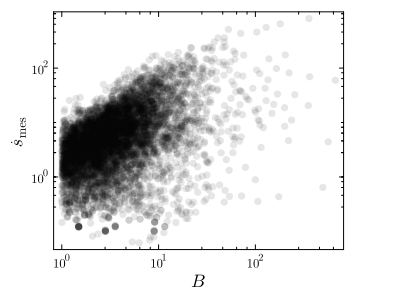

In [490]:
scatter(burst_sizes_esc_Fibroblasts_c57,real_epr_vec_Fibroblasts_c57, xaxis = :log, yaxis = :log, label = :none, color = :black, alpha = 0.1)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"B", ylabel = L"\dot{s}_{\mathrm{mes}}")

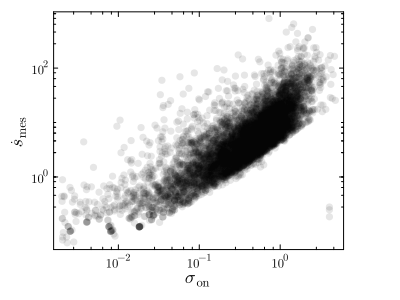

In [491]:
scatter(burst_freqs_Fibroblasts_c57,real_epr_vec_Fibroblasts_c57, xaxis = :log, yaxis = :log, label = :none, color = :black, alpha = 0.1)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\sigma_{\mathrm{on}}", ylabel = L"\dot{s}_{\mathrm{mes}}")

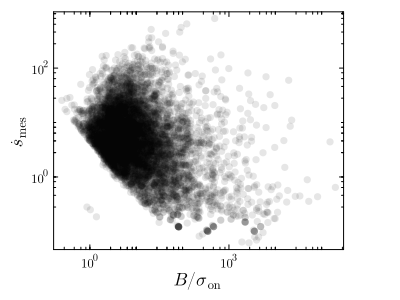

In [492]:
scatter(burst_sizes_esc_Fibroblasts_c57./burst_freqs_Fibroblasts_c57,real_epr_vec_Fibroblasts_c57, xaxis = :log, yaxis = :log, label = :none, color = :black, alpha = 0.1)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"B/\sigma_{\mathrm{on}}", ylabel = L"\dot{s}_{\mathrm{mes}}")

In [311]:
rand_epr_vec_Fibroblasts_c57 = zeros(size(all_data_Fibroblasts_c57)[1]);
for i in 1:nrow(all_data_Fibroblasts_c57)
    son_i = all_data_Fibroblasts_c57[rand(1:size(all_data_Fibroblasts_c57)[1]),:][1]; soff_i = all_data_Fibroblasts_c57[rand(1:size(all_data_Fibroblasts_c57)[1]),:][2]; 
    ron_i = all_data_Fibroblasts_c57[rand(1:size(all_data_Fibroblasts_c57)[1]),:][3]; roff_i = all_data_Fibroblasts_c57[rand(1:size(all_data_Fibroblasts_c57)[1]),:][3]/100; 
    rand_epr_vec_Fibroblasts_c57[i] = epr(ron_i, roff_i, son_i, soff_i, e)
end

In [525]:
f8 = fit(Histogram, log10.(rand_epr_vec_Fibroblasts_c57), nbins = 30);
mps8 = midpoints(collect(f8.edges[1]));
bin_width8 = mps8[2]-mps8[1];
pdf8 = f8.weights/(bin_width8*sum(f8.weights));

# Initial guess for the parameters: [Amplitude, Mean, Standard Deviation]
p0 = [2.5, 0.5, 1.0]

# Perform the fit
g_fit8 = curve_fit(gaussian, mps8, pdf8, p0);

g_vec8 = [gaussian(x, g_fit8.param) for x in mps8];

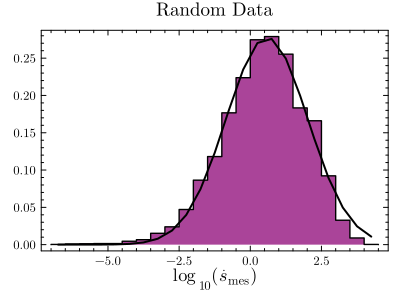

In [526]:
p8 = stephist(log10.(rand_epr_vec_Fibroblasts_c57), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[end], linecolor = :black)
plot!(mps8,g_vec8, color = :black, lw = 2)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", title = "Random Data")

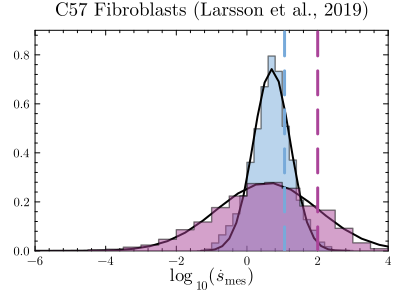

In [529]:
p78comb = stephist(log10.(real_epr_vec_Fibroblasts_c57), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[1], linecolor = :black, alpha = 0.5)
plot!(mps7,g_vec7, color = :black, lw = 2, label = :none)
plot!(mps8,g_vec8, color = :black, lw = 2, label = :none)
stephist!(log10.(rand_epr_vec_Fibroblasts_c57), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[end], linecolor = :black, alpha = 0.5)
plot!(log10.([mean(real_epr_vec_Fibroblasts_c57),mean(real_epr_vec_Fibroblasts_c57)]),[-10,10], color = cpal[1], lw = 3, linestyle = :dash, label = :none)
plot!(log10.([mean(rand_epr_vec_Fibroblasts_c57),mean(rand_epr_vec_Fibroblasts_c57)]),[-10,10], color = cpal[end], lw = 3, linestyle = :dash, label = :none)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", xlims = [-6,4], ylims = [0,0.9], title = "C57 Fibroblasts (Larsson et al., 2019)")

In [367]:
mean(real_epr_vec_Fibroblasts_c57)

11.630221235203402

In [368]:
median(real_epr_vec_Fibroblasts_c57)

4.947761915560355

In [369]:
std(real_epr_vec_Fibroblasts_c57)

27.306966826065256

In [371]:
mean(rand_epr_vec_Fibroblasts_c57)

100.86673694917502

In [372]:
median(rand_epr_vec_Fibroblasts_c57)

3.404919342417947

In [373]:
std(rand_epr_vec_Fibroblasts_c57)

446.9236775579988

Interesting consequences here...

Can also do the cyclic $CV^2$ of the EPR!

In [364]:
cyclic_epr_vec_esc_CAST = zeros(size(all_data_esc_CAST)[1]);
for i in 1:nrow(all_data_esc_CAST)
    son_i = all_data_esc_CAST[i,:][1]; soff_i = all_data_esc_CAST[i,:][2]; ron_i = all_data_esc_CAST[i,:][3]; roff_i = all_data_esc_CAST[i,:][3]/100; 
    cyclic_epr_vec_esc_CAST[i] = (son_i^2+soff_i^2)/(son_i+soff_i)^2
end

In [365]:
cyc_rand_epr_vec_esc_CAST = zeros(size(all_data_esc_CAST)[1]);
for i in 1:nrow(all_data_esc_CAST)
    son_i = all_data_esc_CAST[rand(1:size(all_data_esc_CAST)[1]),:][1]; soff_i = all_data_esc_CAST[rand(1:size(all_data_esc_CAST)[1]),:][2]; 
    ron_i = all_data_esc_CAST[rand(1:size(all_data_esc_CAST)[1]),:][3]; roff_i = ron_i/100; 
    cyc_rand_epr_vec_esc_CAST[i] = (son_i^2+soff_i^2)/(son_i+soff_i)^2
end

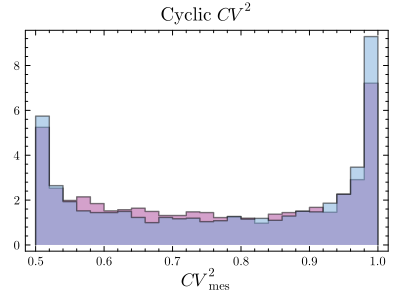

In [366]:
stephist(cyclic_epr_vec_esc_CAST, bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[end], linecolor = :black, alpha = 0.5)
stephist!(cyc_rand_epr_vec_esc_CAST, bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[1], linecolor = :black, alpha = 0.5)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"CV^2_{\mathrm{mes}}", title = L"Cyclic $CV^2$")

## Fibroblasts CAST

In [320]:
raw_data_Fibroblasts_CAST = collect(skipmissing(CSV.read("./data/Larrson-2019-Fibroblasts-CAST.csv", DataFrame, header = 1)[!,2]))
all_data_Fibroblasts_CAST_vec = [
    parse.(Float64, split(replace(strip(s, ['[', ']']), "," => " "))) 
    for s in raw_data_Fibroblasts_CAST
]
matrix_Fibroblasts_CAST = transpose(reshape(vcat(all_data_Fibroblasts_CAST_vec...),(3,length(all_data_Fibroblasts_CAST_vec))))
all_data_Fibroblasts_CAST = DataFrame(matrix_Fibroblasts_CAST, [:kon, :koff, :ksyn]);

In [316]:
real_epr_vec_Fibroblasts_CAST = zeros(size(all_data_Fibroblasts_CAST)[1]);
for i in 1:nrow(all_data_Fibroblasts_CAST)
    son_i = all_data_Fibroblasts_CAST[i,:][1]; soff_i = all_data_Fibroblasts_CAST[i,:][2]; ron_i = all_data_Fibroblasts_CAST[i,:][3]; roff_i = all_data_Fibroblasts_CAST[i,:][3]/100; 
    real_epr_vec_Fibroblasts_CAST[i] = epr(ron_i, roff_i, son_i, soff_i, e)
end

In [530]:
f9 = fit(Histogram, log10.(real_epr_vec_Fibroblasts_CAST), nbins = 30);
mps9 = midpoints(collect(f9.edges[1]));
bin_width9 = mps9[2]-mps9[1];
pdf9 = f9.weights/(bin_width9*sum(f9.weights));

# Initial guess for the parameters: [Amplitude, Mean, Standard Deviation]
p0 = [2.5, 0.5, 1.0]

# Perform the fit
g_fit9 = curve_fit(gaussian, mps9, pdf9, p0);

g_vec9 = [gaussian(x, g_fit9.param) for x in mps9];

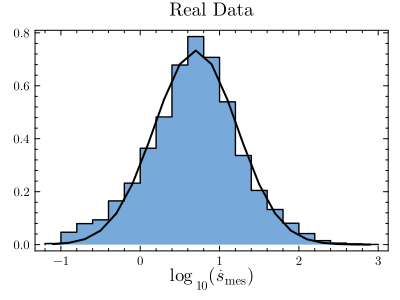

In [531]:
p9 = stephist(log10.(real_epr_vec_Fibroblasts_CAST), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[1], linecolor = :black)
plot!(mps9,g_vec9, color = :black, lw = 2)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", title = "Real Data")

In [494]:
burst_sizes_esc_Fibroblasts_CAST = all_data_Fibroblasts_CAST[!,:ksyn]./all_data_Fibroblasts_CAST[!,:koff]; burst_freqs_Fibroblasts_CAST = all_data_Fibroblasts_CAST[!,:kon];

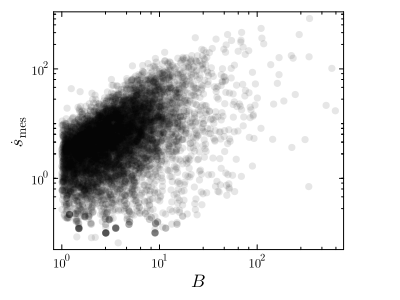

In [495]:
scatter(burst_sizes_esc_Fibroblasts_CAST,real_epr_vec_Fibroblasts_CAST, xaxis = :log, yaxis = :log, label = :none, color = :black, alpha = 0.1)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"B", ylabel = L"\dot{s}_{\mathrm{mes}}")

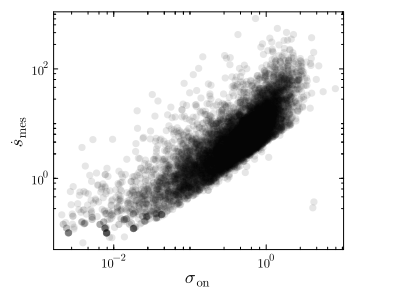

In [496]:
scatter(burst_freqs_Fibroblasts_CAST,real_epr_vec_Fibroblasts_CAST, xaxis = :log, yaxis = :log, label = :none, color = :black, alpha = 0.1)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\sigma_{\mathrm{on}}", ylabel = L"\dot{s}_{\mathrm{mes}}")

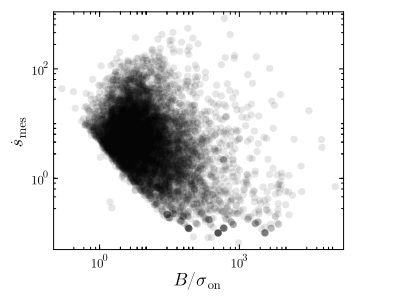

In [497]:
scatter(burst_sizes_esc_Fibroblasts_CAST./burst_freqs_Fibroblasts_CAST,real_epr_vec_Fibroblasts_CAST, xaxis = :log, yaxis = :log, label = :none, color = :black, alpha = 0.1)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"B/\sigma_{\mathrm{on}}", ylabel = L"\dot{s}_{\mathrm{mes}}")

In [330]:
rand_epr_vec_Fibroblasts_CAST = zeros(size(all_data_Fibroblasts_CAST)[1]);
for i in 1:nrow(all_data_Fibroblasts_CAST)
    son_i = all_data_Fibroblasts_CAST[rand(1:size(all_data_Fibroblasts_CAST)[1]),:][1]; soff_i = all_data_Fibroblasts_CAST[rand(1:size(all_data_Fibroblasts_CAST)[1]),:][2]; 
    ron_i = all_data_Fibroblasts_CAST[rand(1:size(all_data_Fibroblasts_CAST)[1]),:][3]; roff_i = all_data_Fibroblasts_c57[rand(1:size(all_data_Fibroblasts_CAST)[1]),:][3]/100; 
    rand_epr_vec_Fibroblasts_CAST[i] = epr(ron_i, roff_i, son_i, soff_i, e)
end

In [532]:
f10 = fit(Histogram, log10.(rand_epr_vec_Fibroblasts_CAST), nbins = 30);
mps10 = midpoints(collect(f10.edges[1]));
bin_width10 = mps10[2]-mps10[1];
pdf10 = f10.weights/(bin_width10*sum(f10.weights));

# Initial guess for the parameters: [Amplitude, Mean, Standard Deviation]
p0 = [2.5, 0.5, 1.0]

# Perform the fit
g_fit10 = curve_fit(gaussian, mps10, pdf10, p0);

g_vec10 = [gaussian(x, g_fit10.param) for x in mps10];

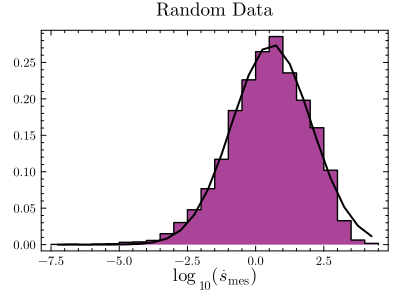

In [533]:
p10 = stephist(log10.(rand_epr_vec_Fibroblasts_CAST), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[end], linecolor = :black)
plot!(mps10,g_vec10, color = :black, lw = 2)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", title = "Random Data")

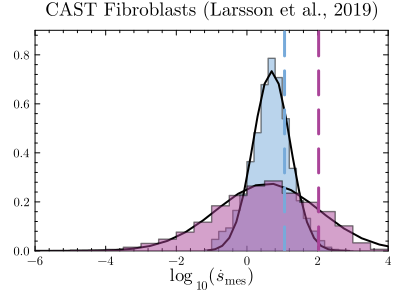

In [535]:
p910comb = stephist(log10.(real_epr_vec_Fibroblasts_CAST), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[1], linecolor = :black, alpha = 0.5)
plot!(mps9,g_vec9, color = :black, lw = 2, label = :none)
plot!(mps10,g_vec10, color = :black, lw = 2, label = :none)
stephist!(log10.(rand_epr_vec_Fibroblasts_CAST), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[end], linecolor = :black, alpha = 0.5)
plot!(log10.([mean(real_epr_vec_Fibroblasts_CAST),mean(real_epr_vec_Fibroblasts_CAST)]),[-10,10], color = cpal[1], lw = 3, linestyle = :dash, label = :none)
plot!(log10.([mean(rand_epr_vec_Fibroblasts_CAST),mean(rand_epr_vec_Fibroblasts_CAST)]),[-10,10], color = cpal[end], lw = 3, linestyle = :dash, label = :none)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", xlims = [-6,4], ylims = [0,0.9], title = "CAST Fibroblasts (Larsson et al., 2019)")

## Fibroblasts ActiveX

In [333]:
raw_data_Fibroblasts_aX = collect(skipmissing(CSV.read("./data/Larrson-2019-Fibroblasts-ActiveX.csv", DataFrame, header = 1)[!,2]))
all_data_Fibroblasts_aX_vec = [
    parse.(Float64, split(replace(strip(s, ['[', ']']), "," => " "))) 
    for s in raw_data_Fibroblasts_aX
]
matrix_Fibroblasts_aX = transpose(reshape(vcat(all_data_Fibroblasts_aX_vec...),(3,length(all_data_Fibroblasts_aX_vec))))
all_data_Fibroblasts_aX = DataFrame(matrix_Fibroblasts_aX, [:kon, :koff, :ksyn]);

In [334]:
real_epr_vec_Fibroblasts_aX = zeros(size(all_data_Fibroblasts_aX)[1]);
for i in 1:nrow(all_data_Fibroblasts_aX)
    son_i = all_data_Fibroblasts_aX[i,:][1]; soff_i = all_data_Fibroblasts_aX[i,:][2]; ron_i = all_data_Fibroblasts_aX[i,:][3]; roff_i = all_data_Fibroblasts_aX[i,:][3]/100; 
    real_epr_vec_Fibroblasts_aX[i] = epr(ron_i, roff_i, son_i, soff_i, e)
end

In [536]:
f11 = fit(Histogram, log10.(real_epr_vec_Fibroblasts_aX), nbins = 30);
mps11 = midpoints(collect(f11.edges[1]));
bin_width11 = mps11[2]-mps11[1];
pdf11 = f11.weights/(bin_width11*sum(f11.weights));

# Initial guess for the parameters: [Amplitude, Mean, Standard Deviation]
p0 = [2.5, 0.5, 1.0]

# Perform the fit
g_fit11 = curve_fit(gaussian, mps11, pdf11, p0);

g_vec11 = [gaussian(x, g_fit11.param) for x in mps11];

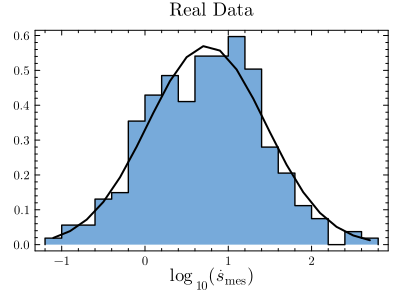

In [537]:
p11 = stephist(log10.(real_epr_vec_Fibroblasts_aX), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[1], linecolor = :black)
plot!(mps11,g_vec11, color = :black, lw = 2)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", title = "Real Data")

In [498]:
burst_sizes_esc_Fibroblasts_aX = all_data_Fibroblasts_aX[!,:ksyn]./all_data_Fibroblasts_aX[!,:koff]; burst_freqs_Fibroblasts_aX = all_data_Fibroblasts_aX[!,:kon];

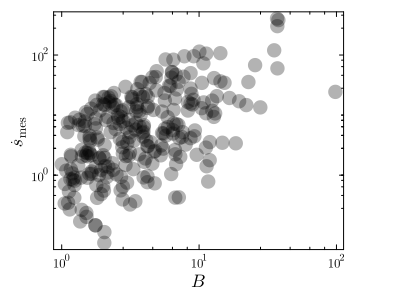

In [511]:
scatter(burst_sizes_esc_Fibroblasts_aX,real_epr_vec_Fibroblasts_aX, xaxis = :log, yaxis = :log, label = :none, color = :black, alpha = 0.3, markersize = 8)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"B", ylabel = L"\dot{s}_{\mathrm{mes}}")

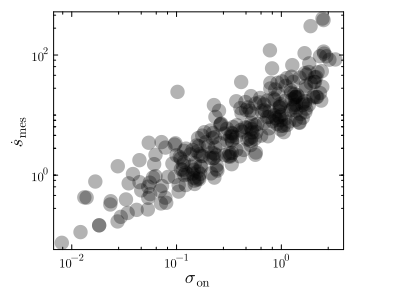

In [512]:
scatter(burst_freqs_Fibroblasts_aX,real_epr_vec_Fibroblasts_aX, xaxis = :log, yaxis = :log, label = :none, color = :black, alpha = 0.3, markersize = 8)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\sigma_{\mathrm{on}}", ylabel = L"\dot{s}_{\mathrm{mes}}")

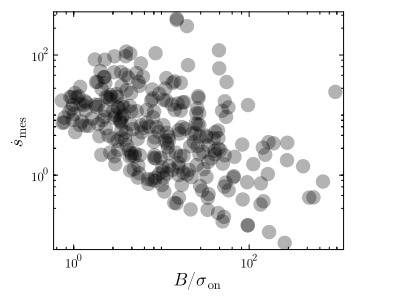

In [515]:
scatter(burst_sizes_esc_Fibroblasts_aX./burst_freqs_Fibroblasts_aX,real_epr_vec_Fibroblasts_aX, xaxis = :log, yaxis = :log, label = :none, color = :black, alpha = 0.3, markersize = 8)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"B/\sigma_{\mathrm{on}}", ylabel = L"\dot{s}_{\mathrm{mes}}")

In [336]:
rand_epr_vec_Fibroblasts_aX = zeros(size(all_data_Fibroblasts_aX)[1]);
for i in 1:nrow(all_data_Fibroblasts_aX)
    son_i = all_data_Fibroblasts_aX[rand(1:size(all_data_Fibroblasts_aX)[1]),:][1]; soff_i = all_data_Fibroblasts_aX[rand(1:size(all_data_Fibroblasts_aX)[1]),:][2]; 
    ron_i = all_data_Fibroblasts_aX[rand(1:size(all_data_Fibroblasts_aX)[1]),:][3]; roff_i = all_data_Fibroblasts_aX[rand(1:size(all_data_Fibroblasts_aX)[1]),:][3]/100; 
    rand_epr_vec_Fibroblasts_aX[i] = epr(ron_i, roff_i, son_i, soff_i, e)
end

In [538]:
f12 = fit(Histogram, log10.(rand_epr_vec_Fibroblasts_aX), nbins = 30);
mps12 = midpoints(collect(f12.edges[1]));
bin_width12 = mps12[2]-mps12[1];
pdf12 = f12.weights/(bin_width12*sum(f12.weights));

# Initial guess for the parameters: [Amplitude, Mean, Standard Deviation]
p0 = [2.5, 0.5, 1.0]

# Perform the fit
g_fit12 = curve_fit(gaussian, mps12, pdf12, p0);

g_vec12 = [gaussian(x, g_fit12.param) for x in mps12];

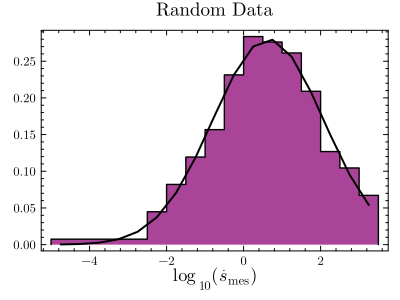

In [539]:
p12 = stephist(log10.(rand_epr_vec_Fibroblasts_aX), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[end], linecolor = :black)
plot!(mps12,g_vec12, color = :black, lw = 2)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", title = "Random Data")

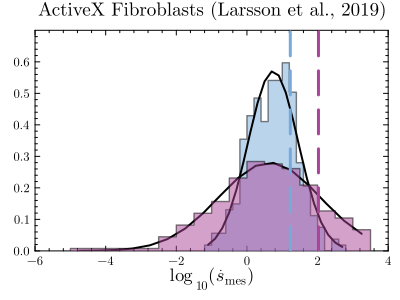

In [542]:
p1112comb = stephist(log10.(real_epr_vec_Fibroblasts_aX), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[1], linecolor = :black, alpha = 0.5)
plot!(mps11,g_vec11, color = :black, lw = 2, label = :none)
plot!(mps12,g_vec12, color = :black, lw = 2, label = :none)
stephist!(log10.(rand_epr_vec_Fibroblasts_aX), bins=30, fill=true, norm = true, legend = :none, fillcolor = cpal[end], linecolor = :black, alpha = 0.5)
plot!(log10.([mean(real_epr_vec_Fibroblasts_aX),mean(real_epr_vec_Fibroblasts_aX)]),[-10,10], color = cpal[1], lw = 3, linestyle = :dash, label = :none)
plot!(log10.([mean(rand_epr_vec_Fibroblasts_aX),mean(rand_epr_vec_Fibroblasts_aX)]),[-10,10], color = cpal[end], lw = 3, linestyle = :dash, label = :none)
plot!(grid = false, minorgrid = false, size = (400,300), xlabel = L"\log_{10}(\dot{s}_{\mathrm{mes}})", xlims = [-6,4], ylims = [0,0.7], title = "ActiveX Fibroblasts (Larsson et al., 2019)")